In [1]:
import geopandas as gpd
from shapely.wkt import loads
import pandas as pd

In [2]:
outlines = gpd.read_file('data/employment_center_outlines.csv').drop(columns=['geometry'])
outlines['the_geom'] = outlines['the_geom'].apply(loads)
outlines = outlines.set_geometry('the_geom')

tracts = gpd.read_file('data/tracts.csv')

In [32]:
tracts = gpd.read_file('data/tracts.csv').drop(columns=['geometry'], dtype={'CT': 'str'})
tracts['the_geom'] = tracts['the_geom'].apply(loads)
tracts = tracts.set_geometry('the_geom')

TypeError: DataFrame.drop() got an unexpected keyword argument 'dtype'

In [31]:
tracts

,the_geom,OBJECTID,CT,URL,CT2010D,CT2010DT,ShapeSTAre,ShapeSTLen
0,"MULTIPOLYGON (((-117.18858 32.75915, -117.1884...",1,100,http://www.sandag.org/resources/demographics_a...,1,1,16567276.032699496,19832.5023541243
1,"MULTIPOLYGON (((-117.17145 32.75796, -117.1714...",2,201,http://www.sandag.org/resources/demographics_a...,2.00999999,2.01,8250527.736699447,11853.222152526725
2,"MULTIPOLYGON (((-117.14476 32.75525, -117.1440...",10,900,http://www.sandag.org/resources/demographics_a...,9,9,6691737.635208414,10359.598997097784
3,"MULTIPOLYGON (((-117.17683 32.75038, -117.1768...",3,202,http://www.sandag.org/resources/demographics_a...,2.01999998,2.02,13709022.639905447,18072.552019334707
4,"MULTIPOLYGON (((-117.16667 32.74899, -117.1664...",4,300,http://www.sandag.org/resources/demographics_a...,3,3,9792098.13695142,14618.348604703382
...,...,...,...,...,...,...,...,...
622,"MULTIPOLYGON (((-117.20792 32.73591, -117.2080...",621,21400,http://www.sandag.org/resources/demographics_a...,214,214,37061155.96877448,35437.15532193762
623,"MULTIPOLYGON (((-117.17296 32.97023, -117.1723...",622,21500,http://www.sandag.org/resources/demographics_a...,215,215,128533787.11059178,51759.55466425884
624,"MULTIPOLYGON (((-117.15063 32.68351, -117.1435...",623,21600,http://www.sandag.org/resources/demographics_a...,216,216,145319134.61747554,56887.309118095065
625,"MULTIPOLYGON (((-117.18460 32.69679, -117.1847...",624,21800,http://www.sandag.org/resources/demographics_a...,218,218,16216697.933103945,24027.51279446243


In [4]:
income = gpd.read_file('data/income_estimates.csv').drop(columns=['geometry'])

In [147]:
tracts.explore()

<Axes: >

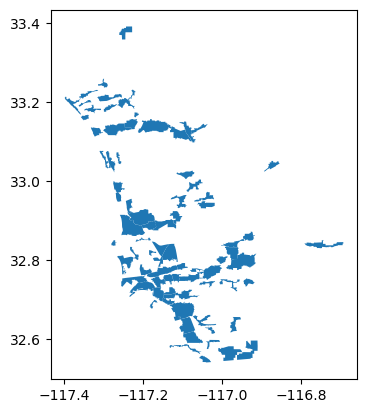

In [148]:
outlines.plot()

In [149]:
outlines_and_tracts = outlines.sjoin(tracts, how='left', predicate='overlaps')

In [150]:
income['households']=income['households'].astype(int)
maxes = income[income['yr_id']=='2022'].groupby(['tract']).max()[['households']].reset_index()
maxes['tract'] = maxes['tract'].astype(str)
merged_not_equal = income.merge(maxes,how='right',on='tract', suffixes=('_right', '_left'))
merge_income= merged_not_equal[merged_not_equal['households_right']==merged_not_equal['households_left']][merged_not_equal['yr_id']=='2022'][merged_not_equal['households_left'].astype(int)>0]

/var/folders/9y/511s41v52w36jc3xv1hv8l2m0000gn/T/ipykernel_25319/1843644176.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  merge_income= merged_not_equal[merged_not_equal['households_right']==merged_not_equal['households_left']][merged_not_equal['yr_id']=='2022'][merged_not_equal['households_left'].astype(int)>0]
/var/folders/9y/511s41v52w36jc3xv1hv8l2m0000gn/T/ipykernel_25319/1843644176.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  merge_income= merged_not_equal[merged_not_equal['households_right']==merged_not_equal['households_left']][merged_not_equal['yr_id']=='2022'][merged_not_equal['households_left'].astype(int)>0]


In [151]:
spatial_income = outlines_and_tracts.merge(merge_income, left_on='CT2010DT', right_on='tract',how='left')

In [152]:
spatial_income.explore()

In [153]:
income[income['tract']=='201.05']

,tract,yr_id,name,households
12390,201.05,2020,"Less than $15,000",73
12391,201.05,2020,"$15,000 to $29,999",160
12392,201.05,2020,"$30,000 to $44,999",45
12393,201.05,2020,"$45,000 to $59,999",151
12394,201.05,2020,"$60,000 to $74,999",116
12395,201.05,2020,"$75,000 to $99,999",290
12396,201.05,2020,"$100,000 to $124,999",193
12397,201.05,2020,"$125,000 to $149,999",103
12398,201.05,2020,"$150,000 to $199,999",179
12399,201.05,2020,"$200,000 or more",118


In [2]:
df = pd.read_csv("data/ca_wac_S000_JT00_2021.csv.gz", compression='gzip', dtype={'w_geocode': 'str'})
df

,w_geocode,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,...,CFA02,CFA03,CFA04,CFA05,CFS01,CFS02,CFS03,CFS04,CFS05,createdate
0,060014001001003,23,1,13,9,0,1,22,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1,060014001001010,8,0,4,4,3,1,4,0,0,...,0,0,0,0,0,0,0,0,0,20231016
2,060014001001011,2,0,1,1,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016
3,060014001001013,5,0,4,1,0,1,4,0,0,...,0,0,0,0,0,0,0,0,0,20231016
4,060014001001015,3,0,0,3,1,0,2,0,0,...,0,0,0,0,0,0,0,0,0,20231016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
252467,061150411021031,5,1,0,4,2,1,2,0,0,...,0,0,0,0,0,0,0,0,0,20231016
252468,061150411021035,3,0,3,0,2,1,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016
252469,061150411021037,11,0,5,6,9,2,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016
252470,061150411021039,4,0,2,2,2,2,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016


In [4]:
sd_county = df[df['w_geocode'].str[:5] == '06073']

In [24]:
sd_county['tract'] = sd_county['w_geocode'].str[5:11]

C:\Users\kng\AppData\Local\Temp\ipykernel_12164\1854726716.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sd_county['tract'] = sd_county['w_geocode'].str[5:11]


In [30]:
sd_county.groupby(['tract']).sum()

,w_geocode,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,...,CFA02,CFA03,CFA04,CFA05,CFS01,CFS02,CFS03,CFS04,CFS05,createdate
tract,,,,,,,,,,,,,,,,,,,,,
000100,0607300010010000607300010010020607300010010030...,222,60,92,70,34,76,112,0,0,...,0,0,0,0,0,0,0,0,0,789009624
000201,0607300020110000607300020110020607300020110060...,968,229,501,238,249,281,438,0,0,...,0,0,0,0,0,0,0,0,0,465313368
000202,0607300020210000607300020210010607300020210020...,761,189,401,171,167,306,288,1,0,...,0,0,0,0,0,0,0,0,0,768778608
000301,0607300030110000607300030110010607300030110020...,369,92,208,69,97,142,130,0,0,...,0,0,0,0,0,0,0,0,0,222541176
000302,0607300030210000607300030210010607300030210020...,4459,1685,2096,678,1214,1713,1532,0,0,...,0,0,0,0,0,0,0,0,0,485544384
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
021800,0607302180010010607302180010020607302180010030...,2292,455,1235,602,375,794,1123,0,0,...,0,0,0,0,0,0,0,0,0,566468448
021900,0607302190010050607302190010060607302190010100...,9930,2021,5528,2381,1100,2933,5897,0,0,...,0,0,0,0,0,0,0,0,0,1699405344
022000,0607302200010000607302200010010607302200010020...,716,139,402,175,158,394,164,0,0,...,0,0,0,0,0,0,0,0,0,222541176


In [42]:
sd_county[sd_county['w_geocode'].str[-4:] == '1000']

,w_geocode,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,...,CFA03,CFA04,CFA05,CFS01,CFS02,CFS03,CFS04,CFS05,createdate,tract
176242,060730001001000,18,9,5,4,0,5,13,0,0,...,0,0,0,0,0,0,0,0,20231016,000100
176281,060730002011000,97,11,62,24,17,31,49,0,0,...,0,0,0,0,0,0,0,0,20231016,000201
176304,060730002021000,11,1,5,5,0,3,8,1,0,...,0,0,0,0,0,0,0,0,20231016,000202
176342,060730003011000,22,1,16,5,4,8,10,0,0,...,0,0,0,0,0,0,0,0,20231016,000301
176353,060730003021000,53,36,15,2,17,26,10,0,0,...,0,0,0,0,0,0,0,0,20231016,000302
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
191884,060730214011000,4,0,2,2,0,3,1,0,0,...,0,0,0,0,0,0,0,0,20231016,021401
191925,060730214021000,3,0,1,2,2,0,1,0,0,...,0,0,0,0,0,0,0,0,20231016,021402
192150,060730220001000,301,71,171,59,47,162,92,0,0,...,0,0,0,0,0,0,0,0,20231016,022000
192161,060730221011000,17,2,11,4,0,6,11,0,0,...,0,0,0,0,0,0,0,0,20231016,022101


In [3]:
blocks = pd.read_csv("data/Census_Blocks_2020_20231117.csv", dtype={'GEOID20': 'str'})
blocks.head()

,the_geom,OBJECTID,GEOID20,GEOID,CT,BLOCK,CTBLOCK,Shape_Length,Shape_Area
0,MULTIPOLYGON (((-117.047699931179 33.383476845...,21466,060730191081004,6073019108,19108,1004,191081004,35038.333218,4.108837e+07
1,MULTIPOLYGON (((-116.962332873289 32.813325783...,15047,060730162021040,6073016202,16202,1040,162021040,959.966234,4.193534e+04
2,MULTIPOLYGON (((-116.891860854062 32.709801773...,27874,060730213063001,6073021306,21306,3001,213063001,1765.784928,1.247016e+05
3,MULTIPOLYGON (((-117.188869934186 33.107658805...,23716,060730200431007,6073020043,20043,1007,200431007,12902.680303,3.802860e+06
4,MULTIPOLYGON (((-117.094423918332 33.111668810...,24872,060730205001003,6073020500,20500,1003,205001003,3191.253616,6.231309e+05


In [45]:
blocks[blocks['BLOCK'] == 1000]

,the_geom,OBJECTID,GEOID20,GEOID,CT,BLOCK,CTBLOCK,Shape_Length,Shape_Area
39,MULTIPOLYGON (((-116.914256869209 32.871660792...,15794,060730168041000,6073016804,16804,1000,168041000,13519.261252,1.223244e+06
43,MULTIPOLYGON (((-117.284320945273 33.036219792...,18245,060730174071000,6073017407,17407,1000,174071000,8391.002446,2.428340e+06
72,MULTIPOLYGON (((-116.635967833102 33.047181826...,25840,060730209021000,6073020902,20902,1000,209021000,52626.875268,6.426378e+07
77,MULTIPOLYGON (((-117.132672899699 32.761018767...,466,060730012021000,6073001202,1202,1000,12021000,2120.064992,2.583714e+05
108,MULTIPOLYGON (((-117.225723912977 32.728700759...,27888,060730214011000,6073021401,21401,1000,214011000,8761.995346,1.493843e+06
...,...,...,...,...,...,...,...,...,...
28421,MULTIPOLYGON (((-117.068285887633 32.760741770...,1361,060730027021000,6073002702,2702,1000,27021000,1668.823016,1.618161e+05
28428,MULTIPOLYGON (((-116.729520848938 33.028683820...,25694,060730208111000,6073020811,20811,1000,208111000,74757.482396,1.118589e+08
28436,MULTIPOLYGON (((-117.171987904699 32.730046761...,4063,060730058011000,6073005801,5801,1000,58011000,1310.318443,1.048659e+05
28456,MULTIPOLYGON (((-117.25101595145 33.1937208124...,22462,060730197021000,6073019702,19702,1000,197021000,10442.910696,1.691600e+06


In [49]:
blocks.join(sd_county, lsuffix='GEOID20', rsuffix='w_geocode').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28474 entries, 0 to 28473
Data columns (total 63 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   the_geom      28474 non-null  object 
 1   OBJECTID      28474 non-null  int64  
 2   GEOID20       28474 non-null  object 
 3   GEOID         28474 non-null  int64  
 4   CT            28474 non-null  int64  
 5   BLOCK         28474 non-null  int64  
 6   CTBLOCK       28474 non-null  int64  
 7   Shape_Length  28474 non-null  float64
 8   Shape_Area    28474 non-null  float64
 9   w_geocode     0 non-null      object 
 10  C000          0 non-null      float64
 11  CA01          0 non-null      float64
 12  CA02          0 non-null      float64
 13  CA03          0 non-null      float64
 14  CE01          0 non-null      float64
 15  CE02          0 non-null      float64
 16  CE03          0 non-null      float64
 17  CNS01         0 non-null      float64
 18  CNS02         0 non-null  

In [7]:
sd_county.join(blocks, lsuffix='w_geocode', rsuffix='GEOID20')

,w_geocode,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,...,createdate,the_geom,OBJECTID,GEOID20,GEOID,CT,BLOCK,CTBLOCK,Shape_Length,Shape_Area
176242,060730001001000,18,9,5,4,0,5,13,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
176243,060730001001002,5,0,2,3,0,2,3,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
176244,060730001001003,1,0,0,1,0,0,1,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
176245,060730001001005,3,0,2,1,0,2,1,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
176246,060730001001010,6,0,2,4,1,0,5,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192213,060730221024008,312,99,169,44,15,54,243,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
192214,060730221024009,2,0,2,0,0,0,2,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
192215,060730221024011,217,66,103,48,55,86,76,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
192216,060730221024012,3,0,1,2,0,1,2,0,0,...,20231016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
# Smaller blocks (find centroid), spatial join on employment center
blocks.head()

,the_geom,OBJECTID,GEOID20,GEOID,CT,BLOCK,CTBLOCK,Shape_Length,Shape_Area
0,MULTIPOLYGON (((-117.047699931179 33.383476845...,21466,060730191081004,6073019108,19108,1004,191081004,35038.333218,4.108837e+07
1,MULTIPOLYGON (((-116.962332873289 32.813325783...,15047,060730162021040,6073016202,16202,1040,162021040,959.966234,4.193534e+04
2,MULTIPOLYGON (((-116.891860854062 32.709801773...,27874,060730213063001,6073021306,21306,3001,213063001,1765.784928,1.247016e+05
3,MULTIPOLYGON (((-117.188869934186 33.107658805...,23716,060730200431007,6073020043,20043,1007,200431007,12902.680303,3.802860e+06
4,MULTIPOLYGON (((-117.094423918332 33.111668810...,24872,060730205001003,6073020500,20500,1003,205001003,3191.253616,6.231309e+05


In [13]:
blocks['GEOID20'].str.len()

0        15
1        15
2        15
3        15
4        15
         ..
28469    15
28470    15
28471    15
28472    15
28473    15
Name: GEOID20, Length: 28474, dtype: int64

In [14]:
sd_county['w_geocode'].str.len()

176242    15
176243    15
176244    15
176245    15
176246    15
          ..
192213    15
192214    15
192215    15
192216    15
192217    15
Name: w_geocode, Length: 15976, dtype: int64

In [16]:
blocks[blocks["GEOID20"] == "060730001001000"]

,the_geom,OBJECTID,GEOID20,GEOID,CT,BLOCK,CTBLOCK,Shape_Length,Shape_Area
6071,MULTIPOLYGON (((-117.186596327046 32.758617222...,1,060730001001000,6073000100,100,1000,1001000,12547.845184,2.844805e+06


In [46]:
# Get all segments of workforce data, loop through each one filter for SD county, then create one big data frame, join the data with census blocks -> check if centroids exist
# in employment center of Downtown
directory = 'data'
import os

In [18]:
os.listdir(directory)

['ca_od_aux_JT00_2021.csv',
 'ca_wac_S000_JT00_2021.csv.gz',
 'ca_wac_SA01_JT00_2021.csv.gz',
 'ca_wac_SA02_JT00_2021.csv.gz',
 'ca_wac_SA03_JT00_2021.csv.gz',
 'ca_wac_SE01_JT00_2021.csv.gz',
 'ca_wac_SE02_JT00_2021.csv.gz',
 'ca_wac_SE03_JT00_2021.csv.gz',
 'ca_wac_SI01_JT00_2021.csv.gz',
 'ca_wac_SI02_JT00_2021.csv.gz',
 'ca_wac_SI03_JT00_2021.csv.gz',
 'Census_Blocks_2020_20231117.csv',
 'employment_center_outlines.csv',
 'income_estimates.csv',
 'series_14_housing_units.csv',
 'tracts.csv']

In [32]:
complete_df = pd.DataFrame()
for file in os.listdir(directory):
    if file.split(".")[-1] == 'gz':
        #add to df
        df = pd.read_csv(os.path.join(directory, file), compression='gzip', dtype={'w_geocode': 'str'})
        complete_df = pd.concat([complete_df, df], ignore_index=True)

complete_df

        



,w_geocode,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,...,CFA02,CFA03,CFA04,CFA05,CFS01,CFS02,CFS03,CFS04,CFS05,createdate
0,060014001001003,23,1,13,9,0,1,22,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1,060014001001010,8,0,4,4,3,1,4,0,0,...,0,0,0,0,0,0,0,0,0,20231016
2,060014001001011,2,0,1,1,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016
3,060014001001013,5,0,4,1,0,1,4,0,0,...,0,0,0,0,0,0,0,0,0,20231016
4,060014001001015,3,0,0,3,1,0,2,0,0,...,0,0,0,0,0,0,0,0,0,20231016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1718134,061150411021031,5,1,0,4,2,1,2,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1718135,061150411021035,3,0,3,0,2,1,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1718136,061150411021037,4,0,3,1,4,0,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1718137,061150411021039,4,0,2,2,2,2,0,0,0,...,0,0,0,0,0,0,0,0,0,20231016


In [47]:
san_diego = complete_df[complete_df['w_geocode'].str[:5] == '06073']
san_diego

,w_geocode,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,...,CFA02,CFA03,CFA04,CFA05,CFS01,CFS02,CFS03,CFS04,CFS05,createdate
176242,060730001001000,18,9,5,4,0,5,13,0,0,...,0,0,0,0,0,0,0,0,0,20231016
176243,060730001001002,5,0,2,3,0,2,3,0,0,...,0,0,0,0,0,0,0,0,0,20231016
176244,060730001001003,1,0,0,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,20231016
176245,060730001001005,3,0,2,1,0,2,1,0,0,...,0,0,0,0,0,0,0,0,0,20231016
176246,060730001001010,6,0,2,4,1,0,5,0,0,...,0,0,0,0,0,0,0,0,0,20231016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1667019,060730221024007,4,0,1,3,1,1,2,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1667020,060730221024008,15,0,14,1,3,2,10,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1667021,060730221024009,2,0,2,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,20231016
1667022,060730221024011,152,42,80,30,33,65,54,0,0,...,0,0,0,0,0,0,0,0,0,20231016


In [48]:
merged_data = san_diego.merge(blocks, left_on="w_geocode", right_on="GEOID20")

In [60]:
merged_data.columns

Index(['w_geocode', 'C000', 'CA01', 'CA02', 'CA03', 'CE01', 'CE02', 'CE03',
       'CNS01', 'CNS02', 'CNS03', 'CNS04', 'CNS05', 'CNS06', 'CNS07', 'CNS08',
       'CNS09', 'CNS10', 'CNS11', 'CNS12', 'CNS13', 'CNS14', 'CNS15', 'CNS16',
       'CNS17', 'CNS18', 'CNS19', 'CNS20', 'CR01', 'CR02', 'CR03', 'CR04',
       'CR05', 'CR07', 'CT01', 'CT02', 'CD01', 'CD02', 'CD03', 'CD04', 'CS01',
       'CS02', 'CFA01', 'CFA02', 'CFA03', 'CFA04', 'CFA05', 'CFS01', 'CFS02',
       'CFS03', 'CFS04', 'CFS05', 'createdate', 'the_geom', 'OBJECTID',
       'GEOID20', 'GEOID', 'CT', 'BLOCK', 'CTBLOCK', 'Shape_Length',
       'Shape_Area'],
      dtype='object')

In [49]:
merged_data.groupby("w_geocode").sum()

,C000,CA01,CA02,CA03,CE01,CE02,CE03,CNS01,CNS02,CNS03,...,createdate,the_geom,OBJECTID,GEOID20,GEOID,CT,BLOCK,CTBLOCK,Shape_Length,Shape_Area
w_geocode,,,,,,,,,,,,,,,,,,,,,
060730001001000,72,36,20,16,0,20,52,0,0,0,...,161848128,MULTIPOLYGON (((-117.186596327046 32.758617222...,8,0607300010010000607300010010000607300010010000...,48584000800,800,8000,8008000,100382.761474,2.275844e+07
060730001001002,20,0,8,12,0,8,12,0,0,0,...,121386096,MULTIPOLYGON (((-117.181383907521 32.755124764...,18,0607300010010020607300010010020607300010010020...,36438000600,600,6012,6006012,6696.004545,3.675498e+05
060730001001003,4,0,0,4,0,0,4,0,0,0,...,80924064,MULTIPOLYGON (((-117.182027907862 32.753583763...,16,0607300010010030607300010010030607300010010030...,24292000400,400,4012,4004012,6448.813771,4.619583e+05
060730001001005,12,0,8,4,0,8,4,0,0,0,...,121386096,MULTIPOLYGON (((-117.182335907098 32.754702764...,36,0607300010010050607300010010050607300010010050...,36438000600,600,6030,6006030,8222.787235,6.145427e+05
060730001001010,24,0,8,16,4,0,20,0,0,0,...,121386096,MULTIPOLYGON (((-117.18857973872 32.7591518559...,66,0607300010010100607300010010100607300010010100...,36438000600,600,6060,6006060,14711.401438,1.992100e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
060730221024008,1248,396,676,176,60,216,972,0,0,0,...,202310160,MULTIPOLYGON (((-117.290323952561 33.119484802...,284620,0607302210240080607302210240080607302210240080...,60730221020,221020,40080,2210240080,116017.700785,5.032238e+07
060730221024009,8,0,8,0,0,0,8,0,0,0,...,80924064,MULTIPOLYGON (((-117.280625950667 33.113648801...,113852,0607302210240090607302210240090607302210240090...,24292088408,88408,16036,884096036,4773.088176,3.431622e+05
060730221024011,868,264,412,192,220,344,304,0,0,0,...,202310160,MULTIPOLYGON (((-117.284121951604 33.119706802...,284650,0607302210240110607302210240110607302210240110...,60730221020,221020,40110,2210240110,30363.832335,3.929987e+06


In [53]:
outlines = gpd.read_file('data/employment_center_outlines.csv').drop(columns=['geometry'])
outlines['the_geom'] = outlines['the_geom'].apply(loads)
outlines = outlines.set_geometry('the_geom')

In [59]:
outlines[outlines['Name'] == 'Downtown']

,the_geom,OBJECTID,Tier,Name
21,"MULTIPOLYGON (((-117.16377 32.73137, -117.1632...",18,1,Downtown
